# This notebook demonstrates the use of Sparse Component Analysis (SCA) using a cycling dataset

Data are trial-averaged firing rates of individual neurons collected from motor cortex (primary motor and dorsal premotor) of a non-human primate.

The monkey was performing a cycling task ([Russo et al., 2018](https://pubmed.ncbi.nlm.nih.gov/29398358/))

Briefly, this task involves the monkey using a bicycle pedal to traverse a virtual environment.

On each trial, the monkey is told how many cycles he will have to perform (0.5, 1,2,4, or 7).

After a variable delay period, the monkey receives a go cue, and he pedals to the target, comes to a stop, and is given a juice reward.

Single-trial rates have been (lightly) stretched or compressed such that each individual cycle is the same duration.

## Import packages

In [1]:
import numpy as np
import scipy
from scipy import io
import time

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sca.models import SCA, WeightedPCA
from sca.util import get_sample_weights, get_accuracy
from plotly.subplots import make_subplots

/opt/anaconda3/envs/ssa/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## local path to the directory
    - fill in the path to whererever you've saved 'datasets'

In [2]:
# local_path = ## FILL IN PATH ##

local_path = '../datasets/'

## Load Data

In [3]:
# load psth and mask data
data=io.loadmat(local_path +'monkeyC_cycling.mat')

# neural data is a matrix (CT x N )
data_array=data['data'] #neural data (CT x N)

# 'mask' was saved as a matlab structure, with fields like 'time','dist','direction'
mask = data['mask']

# grab the field names from mask
keys = mask[0].dtype.descr

# pull out the values
vals = mask[0]

# Assemble the keys and values into variables with the same name as that used in MATLAB
for i in range(len(keys)):
    key = keys[i][0]
    val = np.squeeze(vals[key][0])
    exec(key + '=val')

# we now have variables 'time','dist','dir','pos','cycleNum','condNum','worldPos','firstTimeEachCond','lastTimeEachCond','cellIds', and 'cellNames'

# decimate all of our mask variables
# original length of our mask variables
oL          = time.shape[0]
time_ds     = time[np.arange(0,oL,10)]
dist_ds     = dist[np.arange(0,oL,10)]
dir_ds      = dir[np.arange(0,oL,10)]
condNum_ds  = condNum[np.arange(0,oL,10)]
cyNum_ds    = cycleNum[np.arange(0,oL,10)]

# hard code target onset and move onset (in non-decimated time)
tgt_idx = 500
move_idx = 1500

# how many conditions do we have?
numConds = np.max(condNum_ds)

## Preprocess data
    downsample data by a factor of 10 (to speed up SCA)
    soft normalize each rate (firing rate range across all conditions/times + 5)
        this normalization prevents high firing-rate neurons from dominating the factors

In [4]:
#Downsample data (using a factor of 10 here)
data_downsamp=data_array[np.arange(0,data_array.shape[0],10),:]

#transpose (so the matrix is size N x TC instead of CT x N)
data_concat=data_downsamp.T

#fr range (for normalizing later)
fr_range=np.ptp(data_concat,axis=1)[:,None]

#Soft normalize (divide each neuron by its range + 5)
data_norm=data_concat/(fr_range+5)

# mean-center each neuron
data_snm_norm=data_norm-np.mean(data_norm,axis=1)[:,None]

# rename the data for convenience
#Note that model requires (T x N) input rather than (N x T), which is why there are transposes below
fit_data=np.copy(data_snm_norm.T)

# how much to weight each timestep
sample_weights=get_sample_weights(fit_data)


## Define the SCA hyperparameters
number of dimensions

lam_sparse: how much to penalize non-sparse factors
    for this analysis, we're going to increase lam_sparse by a factor of 10 from the default.
        On this dataset, this increased sparsity gives better (more interpretable) qualitative results while minimally impacting reconstruction accuracy

lam_orthog: how much to penalize non-orthogonal dimensions
    we're going to use the default lam_orthog for this analysis.

In [5]:
# number of dimensions to find
R_est=40

# sparsity lambda
lam_sparse = 0.03

# number of iterations
numIters = 5000

### Fit SCA

Using lam_orthog=  9.570908853772307
Using device cpu


100%|██████████| 5000/5000 [01:53<00:00, 44.18it/s]


SCA R2: 0.9330077011005316


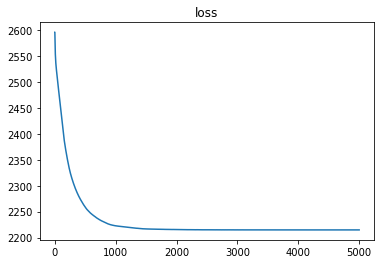

In [6]:
# fit model
sca = SCA(n_components=R_est, lam_sparse=lam_sparse, n_epochs = numIters)
sca_latent = sca.fit_transform(X=fit_data, sample_weight = sample_weights)

# plot loss
plt.plot(sca.losses);
plt.title('loss');

# display fraction of total variance explained by the SCA factors
print('SCA R2: ' + str(sca.r2_score))

In [7]:
# plot the dot product of the SCA weights
V = sca.params['V']
V_dProd = V@V.T

# plot
fig = px.imshow(V_dProd)
fig.update_layout(height = 300, width = 300,title = 'dot product of V')

In [8]:
np.diag(V_dProd)

array([0.99999994, 0.99999934, 1.        , 1.0000002 , 0.9999999 ,
       0.99999994, 1.0000004 , 0.99999976, 1.        , 0.99999994,
       1.        , 0.9999999 , 0.99999994, 1.        , 0.99999976,
       0.99999964, 1.0000004 , 1.0000001 , 1.0000001 , 0.99999976,
       1.0000002 , 1.0000002 , 1.0000002 , 0.99999994, 0.9999999 ,
       1.        , 1.0000002 , 0.99999994, 1.        , 0.99999964,
       1.        , 1.0000002 , 0.99999994, 1.        , 0.9999999 ,
       0.99999976, 1.0000002 , 1.0000005 , 0.99999994, 0.9999998 ],
      dtype=float32)

In [9]:
# define some colors
# red/green corresponds to backward and forward conditions.
# dark/light colors correspond to top-start vs. bottom-start conditions
colors = np.array(['darkgreen','springgreen','maroon','red'])
colors = np.tile(colors,(1,5)).squeeze()

## Plot SCA factors

In [10]:
# number of rows
numRows = int(R_est/2)

# range of y axis
yRange = [-2.5,2.5]

fig = make_subplots(rows=numRows,cols = 2,shared_xaxes = True,vertical_spacing = 0)

for i in range(R_est):
    for j in range(numConds):

        # grab the indices for this condition
        # remember that conditions are 1 indexed
        condIdx = condNum_ds == (j+1)

        # subplot indices
        rowIdx = int(np.mod(i,numRows))+1
        colIdx = int(i/numRows)+1


        tempProj = go.Scatter(x = time_ds[condIdx],y = sca_latent[condIdx,i],
                    line = go.scatter.Line(color = colors[j],width = 2),showlegend = False)
        fig.add_trace(tempProj,row = rowIdx,col=colIdx)

    # add a vertical line for scale
    scaleLine = go.Scatter(x = [0,0],y = [-1,1],showlegend = False,mode = 'lines',
                               line = go.scatter.Line(color = 'black',width = 5))
    fig.add_trace(scaleLine,row = rowIdx,col = colIdx)


fig.update_layout(height = 2000,width =1000,title = 'SCA',title_font_color = 'black',
                  paper_bgcolor = 'white',
                  plot_bgcolor = 'white')
fig.update_yaxes(showgrid = False,zeroline = False,visible = False, range=yRange)
fig.update_xaxes(color = 'black',showgrid = False,zeroline = False,visible = False)
fig.update_xaxes(color = 'black',showgrid = False,zeroline = False,
                 ticks = 'outside',tickvals = [tgt_idx,move_idx],ticktext = ['target','move'],visible = True,row = numRows,col = 1)


### run weighted PCA and plot factors

In [11]:
wpca = WeightedPCA(n_components=R_est)
pca_latent=wpca.fit_transform(X=fit_data, sample_weight=sample_weights)

# calculate reconstruction R2
[pca_r2_score, pca_reconstruction_loss]=get_accuracy(wpca,fit_data,sample_weights)
print('PCA R2: ' + str(pca_r2_score))

# number of rows
numRows = int(R_est/2)

# range of y axis
yRange = [-2.5,2.5]

fig = make_subplots(rows=numRows,cols = 2,shared_xaxes = True,vertical_spacing = 0)

for i in range(R_est):
    for j in range(numConds):

        # grab the indices for this condition
        # remember that conditions are 1 indexed
        condIdx = condNum_ds == (j+1)

        # subplot indices
        rowIdx = int(np.mod(i,numRows))+1
        colIdx = int(i/numRows)+1


        tempProj = go.Scatter(x = time_ds[condIdx],y = pca_latent[condIdx,i],
                    line = go.scatter.Line(color = colors[j],width = 2),showlegend = False)
        fig.add_trace(tempProj,row = rowIdx,col=colIdx)

    # add a vertical line for scale
    scaleLine = go.Scatter(x = [0,0],y = [-1,1],showlegend = False,mode = 'lines',
                               line = go.scatter.Line(color = 'black',width = 5))
    fig.add_trace(scaleLine,row = rowIdx,col = colIdx)


fig.update_layout(height = 2000,width =1000,title = 'weighted PCA',title_font_color = 'black',
                  paper_bgcolor = 'white',
                  plot_bgcolor = 'white')
fig.update_yaxes(showgrid = False,zeroline = False,visible = False, range=yRange)
fig.update_xaxes(color = 'black',showgrid = False,zeroline = False,visible = False)
fig.update_xaxes(color = 'black',showgrid = False,zeroline = False,
                 ticks = 'outside',tickvals = [tgt_idx,move_idx],ticktext = ['target','move'],visible = True,row = numRows,col = 1)


PCA R2: 0.9349575745587881


## Comparisons between SCA and PCA factors
SCA factors fall into one of 4 groups: posture-related, preparatory, steady-state, or stopping-related.

Posture-related factors are active before the target turns on, and/or become active after the movement ends.

preparatory factors are only active after the target turns on and cease being active after movement
steady-state factors are active during movement

stopping-related factors are only active shortly before/during the final cycle of a movement.

PCA factors are a mess
